In [1]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
uber_15 =pd.read_csv('uber-raw-data-janjune-15.csv')

In [3]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [4]:
uber_15.shape

(14270479, 4)

In [5]:
# Finding duplicate values
uber_15.duplicated().sum()

898225

In [6]:
# Dropping duplicate values
uber_15.drop_duplicates(inplace=True)

In [7]:
uber_15.duplicated().sum()

0

In [8]:
uber_15.shape

(13372254, 4)

## Which month has max pickups?

In [9]:
uber_15.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [10]:
#Converting columns Pickup_date from object to datetype.
uber_15['Pickup_date']=pd.to_datetime(uber_15['Pickup_date'], format='%Y-%m-%d %H:%M:%S')

In [11]:
uber_15['Pickup_date'].dtypes

dtype('<M8[ns]')

In [12]:
uber_15['month']=uber_15['Pickup_date'].dt.month

In [13]:
uber_15['month'].value_counts()

6    2571771
5    2483980
2    2222189
4    2112705
3    2062639
1    1918970
Name: month, dtype: int64

<AxesSubplot:>

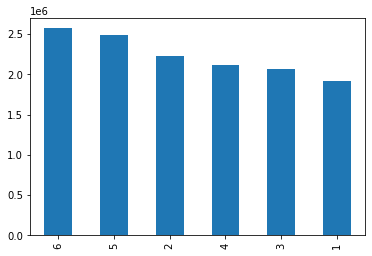

In [14]:
uber_15['month'].value_counts().plot(kind='bar')

* So the 6th month ie June month the Uber pickups has the maximum pickups of count 2571771.

## Total trips in each month and each weekdays

In [15]:
uber_15['weekday']=uber_15['Pickup_date'].dt.day_name()
uber_15['day']=uber_15['Pickup_date'].dt.day
uber_15['hour']=uber_15['Pickup_date'].dt.hour
uber_15['month']=uber_15['Pickup_date'].dt.month
uber_15['minute']=uber_15['Pickup_date'].dt.minute

In [16]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,month,weekday,day,hour,minute
0,B02617,2015-05-17 09:47:00,B02617,141,5,Sunday,17,9,47
1,B02617,2015-05-17 09:47:00,B02617,65,5,Sunday,17,9,47
2,B02617,2015-05-17 09:47:00,B02617,100,5,Sunday,17,9,47
3,B02617,2015-05-17 09:47:00,B02774,80,5,Sunday,17,9,47
4,B02617,2015-05-17 09:47:00,B02617,90,5,Sunday,17,9,47


In [17]:
temp = uber_15.groupby(['month', 'weekday'], as_index=False).size()
temp.head(10)

,month,weekday,size
0,1,Friday,339285
1,1,Monday,190606
2,1,Saturday,386049
3,1,Sunday,230487
4,1,Thursday,330319
5,1,Tuesday,196574
6,1,Wednesday,245650
7,2,Friday,373550
8,2,Monday,274948
9,2,Saturday,368311


In [18]:
temp['month'].unique()

array([1, 2, 3, 4, 5, 6], dtype=int64)

In [19]:
dict_month = {1:'Jan', 2:'Feb', 3:'March', 4:'April', 5:'May', 6:'June'}

In [20]:
temp['month'].map(dict_month)

0       Jan
1       Jan
2       Jan
3       Jan
4       Jan
5       Jan
6       Jan
7       Feb
8       Feb
9       Feb
10      Feb
11      Feb
12      Feb
13      Feb
14    March
15    March
16    March
17    March
18    March
19    March
20    March
21    April
22    April
23    April
24    April
25    April
26    April
27    April
28      May
29      May
30      May
31      May
32      May
33      May
34      May
35     June
36     June
37     June
38     June
39     June
40     June
41     June
Name: month, dtype: object

In [21]:
temp

,month,weekday,size
0,1,Friday,339285
1,1,Monday,190606
2,1,Saturday,386049
3,1,Sunday,230487
4,1,Thursday,330319
5,1,Tuesday,196574
6,1,Wednesday,245650
7,2,Friday,373550
8,2,Monday,274948
9,2,Saturday,368311


<AxesSubplot:xlabel='month', ylabel='size'>

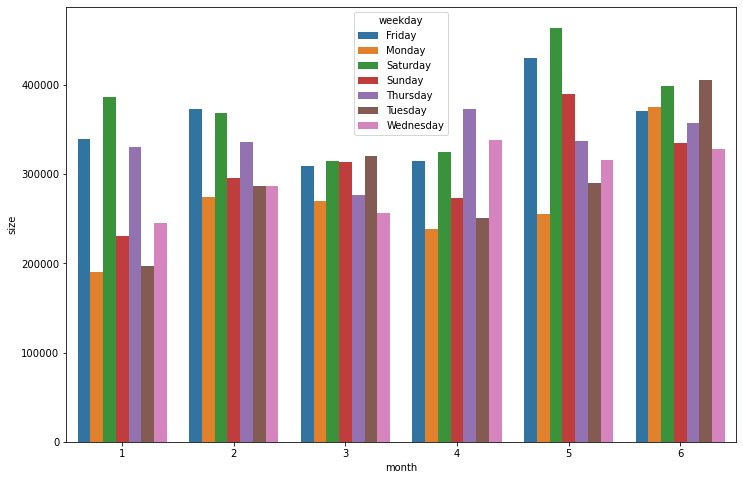

In [22]:
plt.figure(figsize=(12,8))
sns.barplot(x='month', y='size', hue='weekday', data=temp)

* In the month of May and weekday Saturday Uber had maximum pickups of the count 464298. 

## Hourly Rush in New York city on all days

In [23]:
# Creating a group of weekday and hour and counting total number of rides.
summary = uber_15.groupby(['weekday', 'hour'], as_index= False).size()
summary.head()

,weekday,hour,size
0,Friday,0,79879
1,Friday,1,44563
2,Friday,2,27252
3,Friday,3,19076
4,Friday,4,23049


<AxesSubplot:xlabel='hour', ylabel='size'>

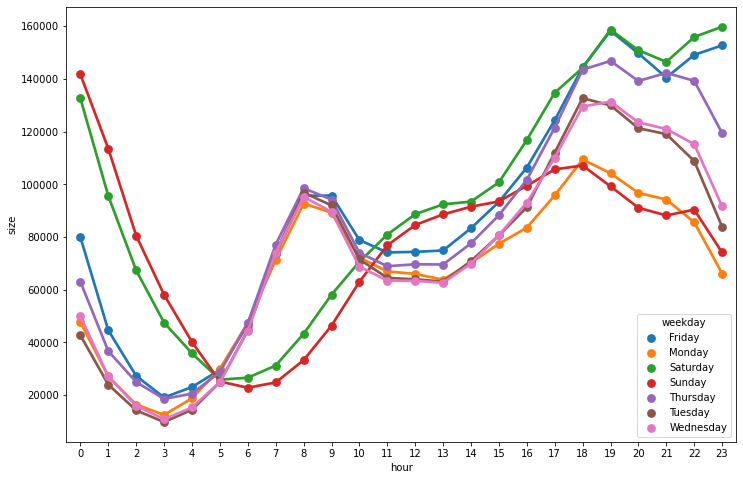

In [24]:
#Creating a pointplot graph of the summary dataframe
plt.figure(figsize=(12,8))
sns.pointplot(x='hour', y='size', hue='weekday', data=summary)

* Sunday and Saturday have very high amount of rush from as the particular days began, later the day progress the rush keeps on   decreasing till 5:00 hrs. After that Saturday hourly ride keeps on increasing throughout the day whereas the hourly rides for   Sunday increases till 18:00 hr and then takes a dip as the day progresses.
* On Weekend ie Saturday and Friday the hourly rush is huge late at night.
* On weekdays hourly rush is less early in the day and pickups is common and maximum from 5:00 - 10:00 hrs.


## Which Base number has most number of active vehicles

In [25]:
uber_foil = pd.read_csv(r'Uber-Jan-Feb-Foil.csv')
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [26]:
import chart_studio as py
import plotly.graph_objs as go
import plotly.express as px
from plotly.offline import iplot, download_plotlyjs, plot, init_notebook_mode
init_notebook_mode(connected=True)

In [27]:
px.box(x='dispatching_base_number', y='active_vehicles', data_frame=uber_foil)

In [28]:
px.violin(x='dispatching_base_number', y='active_vehicles', data_frame=uber_foil)

* Base number B02764 has most number of active vehicle distribution

## Collecting entire data

In [29]:
import os

In [30]:
files = os.listdir(r'D:\yash\Data analysis projects\Uber New York')[-8:-1]
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [31]:
files.remove('uber-raw-data-janjune-15.csv')

In [32]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [33]:
path = r'D:\yash\Data analysis projects\Uber New York'

final=pd.DataFrame()

for file in files:
    current_df = pd.read_csv(path+'/'+ file, encoding='utf-8')
    final = pd.concat([current_df, final])

In [34]:
final.shape

(4534327, 4)

In [35]:
final.head()

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512
3,9/1/2014 0:06:00,40.7450,-73.9889,B02512
4,9/1/2014 0:11:00,40.8145,-73.9444,B02512


In [36]:
#Removing duplicate values from the final dataframe
final.duplicated().sum()

82581

In [37]:
final.drop_duplicates(inplace=True)

In [38]:
final.duplicated().sum()

0

In [39]:
final.shape

(4451746, 4)

## At what locations of New York city we are getting rush

In [42]:
rush_uber = final.groupby(['Lat', 'Lon'], as_index=False).size()
rush_uber

,Lat,Lon,size
0,39.6569,-74.2258,1
1,39.6686,-74.1607,1
2,39.7214,-74.2446,1
3,39.8416,-74.1512,1
4,39.9055,-74.0791,1
...,...,...,...
574553,41.3730,-72.9237,1
574554,41.3737,-73.7988,1
574555,41.5016,-72.8987,1
574556,41.5276,-72.7734,1


In [43]:
import folium

In [44]:
basemap= folium.Map()

In [46]:
from folium.plugins import HeatMap

In [47]:
HeatMap(rush_uber).add_to(basemap)

In [49]:
basemap

 * Midtown Manhattan has huge bright red spot which indicates there is huge number of Uber pickups from this area.
 * There is bright slightly light red spot at Upper and Lower Manhattan as well depicting great number of Uber pickups in          Manhattan region.
 * As we move towards the outskirts of New York region uber pickup spots keeps getting lighter depicting lesser uber pickups in this area.